<h1><center> Computer Vision Project </center></h1>


<h1><center> Elaborated by: Nesrine Sfar & Habib Aouinti </center></h1>

This notebook uses the **VGG16 model** for crop image classification. 
* VGG16 is a convolutional neural network architecture that has been pre-trained on large-scale image datasets and is commonly used for image classification tasks. The VGG16 model is employed to provides a practical implementation of the VGG16 model for crop image classification, leveraging its pre-trained weights and architecture to achieve accurate predictions.
* The VGG16 model has an image input size of 224-by-224 and is characterized by its deep architecture with 16 weight layers, consisting of convolutional and fully connected layers.
* The use of VGG16 for crop image classification has been found to be superior to other pre-trained models like ResNet50
* The VGG16 model is known for its simplicity and utilization of small 3 x 3 filters, making it effective for image recognition tasks

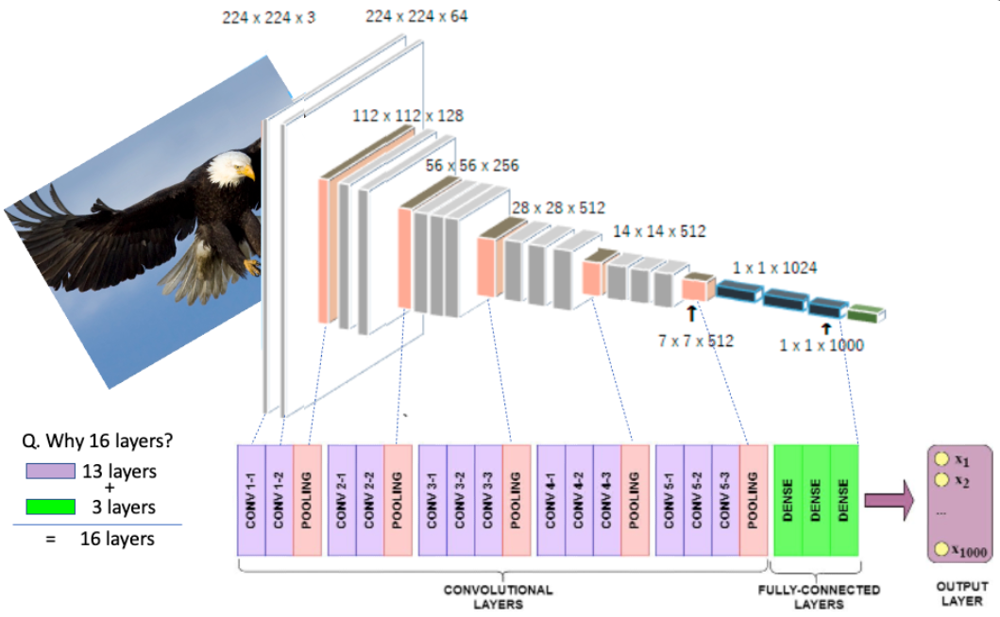

# First of all we start by getting the paths of our dataset

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))
        break

# You can write up to 5GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/agriculture-crop-images/Crop_details.csv
/kaggle/input/agriculture-crop-images/test_crop_image/maize000.jfif
/kaggle/input/agriculture-crop-images/some_more_images/some_more_images/jute/jute041a.jpg
/kaggle/input/agriculture-crop-images/some_more_images/some_more_images/maize/maize042a.jpg
/kaggle/input/agriculture-crop-images/some_more_images/some_more_images/Wheat/wheat044a.jpg
/kaggle/input/agriculture-crop-images/some_more_images/some_more_images/sugarcane/sugarcane048a.jpg
/kaggle/input/agriculture-crop-images/some_more_images/some_more_images/rice/rice041a.jpg
/kaggle/input/agriculture-crop-images/crop_images/jute/jute025a.jpeg
/kaggle/input/agriculture-crop-images/crop_images/maize/maize034a.jpeg
/kaggle/input/agriculture-crop-images/crop_images/wheat/wheat024a.jpeg
/kaggle/input/agriculture-crop-images/crop_images/sugarcane/sugarcane038a.jpeg
/kaggle/input/agriculture-crop-images/crop_images/rice/rice025a.jpeg
/kaggle/input/agriculture-crop-images/kag2/jute/jute02

# Loading modules

In [2]:
%matplotlib inline
import warnings
warnings.filterwarnings('ignore')
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import seaborn as sns
import tensorflow as tf 
import keras 
from keras.layers import Conv2D
from keras.models import Sequential
from keras.layers import MaxPool2D
from keras.layers import Flatten
from keras.layers import Dense
from keras.models import Model
from keras.preprocessing.image import ImageDataGenerator
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
import cv2
import re
import random
random.seed(0)
np.random.seed(0)

# Plotting some images

Text(0.5, 1.0, 'wheat')

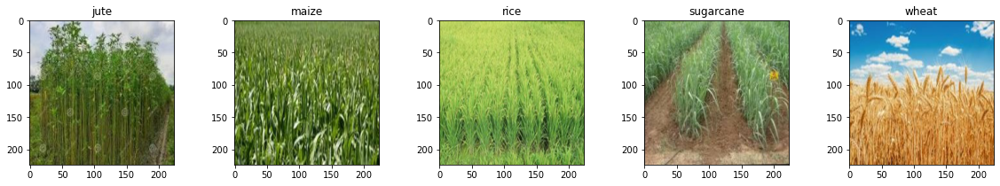

In [3]:
wheat = plt.imread("/kaggle/input/agriculture-crop-images/kag2/wheat/wheat0004a.jpeg")
jute = plt.imread("/kaggle/input/agriculture-crop-images/kag2/jute/jute005a.jpeg")
cane = plt.imread("/kaggle/input/agriculture-crop-images/kag2/sugarcane/sugarcane0010arot.jpeg")
rice = plt.imread("/kaggle/input/agriculture-crop-images/kag2/rice/rice032ahs.jpeg")
maize = plt.imread("/kaggle/input/agriculture-crop-images/kag2/maize/maize003a.jpeg")
plt.figure(figsize=(20,3))
plt.subplot(1,5,1)
plt.imshow(jute)
plt.title("jute")
plt.subplot(1,5,2)
plt.imshow(maize)
plt.title("maize")
plt.subplot(1,5,3)
plt.imshow(rice)
plt.title("rice")
plt.subplot(1,5,4)
plt.imshow(cane)
plt.title("sugarcane")
plt.subplot(1,5,5)
plt.imshow(wheat)
plt.title("wheat")

# Converting to training and testing data

In [4]:
jutepath = "../input/agriculture-crop-images/kag2/jute"
maizepath = "../input/agriculture-crop-images/kag2/maize"
ricepath = "../input/agriculture-crop-images/kag2/rice"
sugarcanepath = "../input/agriculture-crop-images/kag2/sugarcane"
wheatpath = "../input/agriculture-crop-images/kag2/wheat"

jutefilename = os.listdir(jutepath)
maizefilename = os.listdir(maizepath)
ricefilename = os.listdir(ricepath)
sugarcanefilename = os.listdir(sugarcanepath)
wheatfilename = os.listdir(wheatpath)

X= []

In [5]:
for fname in jutefilename:
    X.append([os.path.join(jutepath,fname),0])
for fname in maizefilename:
    X.append([os.path.join(maizepath,fname),1])
for fname in ricefilename:
    X.append([os.path.join(ricepath,fname),2])
for fname in sugarcanefilename:
    X.append([os.path.join(sugarcanepath,fname),3]) 
for fname in wheatfilename:
    X.append([os.path.join(wheatpath,fname),4])  
X = pd.DataFrame(X,columns = ['path','labels'])    

In [6]:
X.head()

,path,labels
0,../input/agriculture-crop-images/kag2/jute/jut...,0
1,../input/agriculture-crop-images/kag2/jute/jut...,0
2,../input/agriculture-crop-images/kag2/jute/jut...,0
3,../input/agriculture-crop-images/kag2/jute/jut...,0
4,../input/agriculture-crop-images/kag2/jute/jut...,0


# Checking if the Dataset is balanced

4    164
3    160
2    160
1    160
0    160
Name: labels, dtype: int64

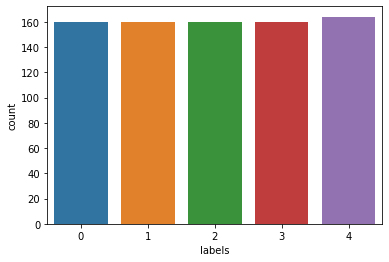

In [7]:
#getting our X_train and y_train variables from the train dataset
Y=X['labels']
#X_train=new_X.drop(labels=['croplabel'],axis=1)
g=sns.countplot(x=Y)
Y.value_counts()

# Creating a OneHotEncoder

In [8]:

ohencoder = OneHotEncoder(handle_unknown='ignore',sparse=False)
ohlabel = pd.DataFrame(ohencoder.fit_transform(X[['labels']]),dtype = 'float64',columns = ['label0','label1','label2','label3','label4'])
label_X = X.copy()
X = pd.concat([X,ohlabel],axis = 1)
new_X = X.drop(['labels'],axis = 1)

In [15]:
new_X

,path,label0,label1,label2,label3,label4
0,../input/agriculture-crop-images/kag2/jute/jut...,1.0,0.0,0.0,0.0,0.0
1,../input/agriculture-crop-images/kag2/jute/jut...,1.0,0.0,0.0,0.0,0.0
2,../input/agriculture-crop-images/kag2/jute/jut...,1.0,0.0,0.0,0.0,0.0
3,../input/agriculture-crop-images/kag2/jute/jut...,1.0,0.0,0.0,0.0,0.0
4,../input/agriculture-crop-images/kag2/jute/jut...,1.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...
799,../input/agriculture-crop-images/kag2/wheat/wh...,0.0,0.0,0.0,0.0,1.0
800,../input/agriculture-crop-images/kag2/wheat/wh...,0.0,0.0,0.0,0.0,1.0
801,../input/agriculture-crop-images/kag2/wheat/wh...,0.0,0.0,0.0,0.0,1.0
802,../input/agriculture-crop-images/kag2/wheat/wh...,0.0,0.0,0.0,0.0,1.0


# Splitting Dataset into training and Testing

In [9]:
train,test = train_test_split(new_X,test_size=0.2,random_state=32,shuffle = True)

In [10]:
X_train = train['path'].values
y_train = train.drop(['path'],axis=1).values
X_test = test['path'].values
y_test = test.drop(['path'],axis=1).values

# Normalizing, Reshaping and Flattening

The purpose of the deep_pipeline function in the provided notebook is to prepare the input data for the VGG model. The function reads the image files, rescales the pixel values to be between 0 and 1, and reshapes the images to the dimensions expected by the VGG model (224x224x3). This preprocessing is essential to ensure that the input data is in the correct format and range for the VGG model to make predictions accurately

In [11]:
def deep_pipeline(data):
    flat = []
    for i in data:
        img = plt.imread(i)
        img = img/255.
        flat.append(img)
    flat =  np.array(flat)    
    flat = flat.reshape(-1,224,224,3)       
    return flat
    

In [12]:
dx_train = deep_pipeline(X_train)
dx_test = deep_pipeline(X_test)

# Model training

The provided code in the notebook serves the following purposes:
* Loading Pre-trained VGG19 Model: It loads the VGG19 model without the top (fully connected) layers and specifies the input shape, that is (224, 224, 3). The include_top parameter is set to False to exclude the top layers.
* Adding Custom Dense Layers: It adds custom dense layers on top of the VGG19 base to create a new model for the specific classification task. The last dense layer has 5 nodes with a softmax activation function, which is suitable for multi-class classification.
* Loading Pre-trained Weights: It loads the pre-trained weights from the specified local path into the VGG19 model.
* Compiling the Model: It compiles the VGG19-based model using the Adam optimizer, categorical cross-entropy loss, and accuracy as the metric.


In [47]:
from tensorflow.keras.applications.vgg19 import VGG19
from tensorflow.keras.layers import Dense
from tensorflow.keras.models import Sequential

# Specify the local path to the downloaded weights file
weights_path = '/kaggle/input/vvggggg/vgg19_weights_tf_dim_ordering_tf_kernels_notop.h5'

# Create the VGG19 model without downloading weights
vgg = VGG19(input_shape=(224, 224, 3), include_top=False, weights=None, pooling='avg')
vgg.trainable = False

# Build your model on top of the VGG19 base
vggmodel = Sequential([vgg, Dense(1000, activation='tanh'), Dense(1000, activation='tanh'), Dense(1000, activation='tanh'), Dense(5, activation='softmax')])

# Load only the matching layers
vggmodel.layers[0].load_weights(weights_path, by_name=True)

# Compile the model and print the summary
vggmodel.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])



it demonstrates the process of using a pre-trained VGG19 model as a feature extractor and building a new model on top of it for a specific classification task. 
The pre-trained weights are loaded to leverage the knowledge gained from the original training on ImageNet data, and the custom dense layers are added to adapt the model to the new task.

In [48]:
vggmodel.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg19 (Model)                (None, 512)               20024384  
_________________________________________________________________
dense_4 (Dense)              (None, 1000)              513000    
_________________________________________________________________
dense_5 (Dense)              (None, 1000)              1001000   
_________________________________________________________________
dense_6 (Dense)              (None, 1000)              1001000   
_________________________________________________________________
dense_7 (Dense)              (None, 5)                 5005      
Total params: 22,544,389
Trainable params: 2,520,005
Non-trainable params: 20,024,384
_________________________________________________________________


In [14]:
hist = vggmodel.fit(dx_train,y_train,epochs=50,validation_split=0.3,batch_size=16)

Epoch 1/50
29/29 [==============================] - 3s 103ms/step - loss: 2.8285 - accuracy: 0.3222 - val_loss: 1.8803 - val_accuracy: 0.2850
Epoch 2/50
29/29 [==============================] - 2s 72ms/step - loss: 1.4299 - accuracy: 0.4622 - val_loss: 1.2769 - val_accuracy: 0.4611
Epoch 3/50
29/29 [==============================] - 2s 72ms/step - loss: 1.0312 - accuracy: 0.6044 - val_loss: 0.8772 - val_accuracy: 0.6891
Epoch 4/50
29/29 [==============================] - 2s 71ms/step - loss: 1.0084 - accuracy: 0.6200 - val_loss: 1.1061 - val_accuracy: 0.5389
Epoch 5/50
29/29 [==============================] - 2s 72ms/step - loss: 0.8527 - accuracy: 0.6844 - val_loss: 1.0004 - val_accuracy: 0.5959
Epoch 6/50
29/29 [==============================] - 2s 72ms/step - loss: 0.6253 - accuracy: 0.7644 - val_loss: 0.5857 - val_accuracy: 0.7927
Epoch 7/50
29/29 [==============================] - 2s 72ms/step - loss: 0.4549 - accuracy: 0.8200 - val_loss: 0.6209 - val_accuracy: 0.7565
Epoch 8/50
2

the model finished training with **100% accuracy** on the training set and **92.75% accuracy** on the validation set

# Accuracy and Loss comparison between Training and Validation sets

(0.0, 4.0)

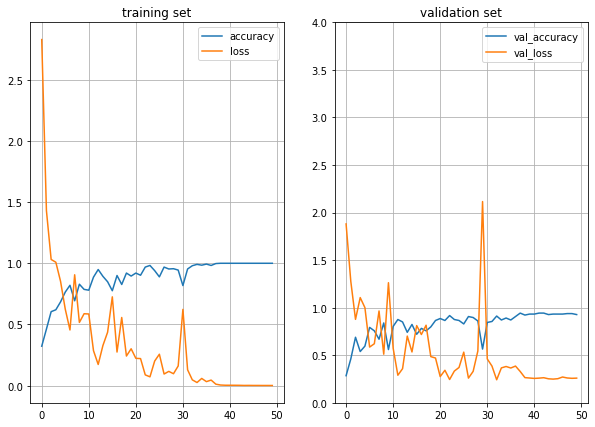

In [16]:
plt.figure(figsize=(10,7))
plt.subplot(1,2,1)
plt.plot(hist.history['accuracy'],label='accuracy')
plt.plot(hist.history['loss'],label='loss')
plt.legend()
plt.title("training set")
plt.grid()
plt.subplot(1,2,2)
plt.plot(hist.history['val_accuracy'],label='val_accuracy')
plt.plot(hist.history['val_loss'],label='val_loss')
plt.legend()
plt.title("validation set")
plt.grid()
plt.ylim((0,4))

# Test set accuracy

In [17]:
score = vggmodel.evaluate(dx_test,y_test)
print("accuracy: ", score[1])

6/6 [==============================] - 0s 63ms/step - loss: 0.2980 - accuracy: 0.9379
accuracy:  0.9378882050514221


In [18]:
pred = vggmodel.predict(dx_test)
prediction = np.argmax(pred,axis=1)
true = np.argmax(y_test,axis=1)
best_prob = [pred[num,:][i] for num,i in enumerate(prediction)]

# Confusion Matrix

A confusion matrix is a table used to evaluate a classification model by summarizing the counts of correct and incorrect classifications. It provides insights into the model's performance, allowing for the calculation of metrics such as accuracy, precision, recall, and F1-score. The confusion matrix is a valuable tool for understanding the strengths and weaknesses of a classification model and identifying areas for improvement.

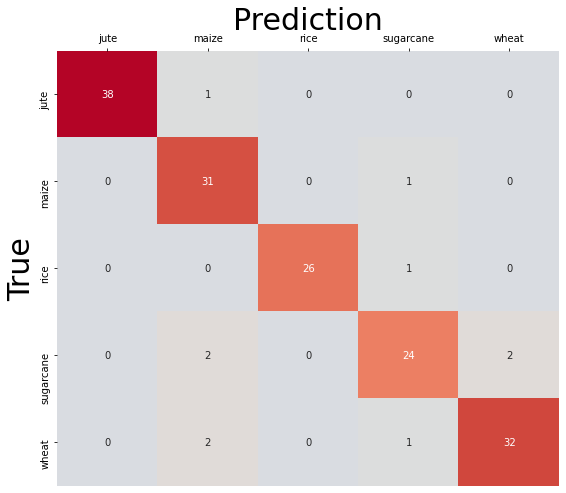

In [19]:
plt.figure(figsize = (9,8))
class_label = ['jute','maize','rice','sugarcane','wheat']
fig = sns.heatmap(confusion_matrix(true,prediction),cmap= "coolwarm",annot=True,vmin=0,cbar = False,
            center = True,xticklabels=class_label,yticklabels=class_label)
fig.set_xlabel("Prediction",fontsize=30)
fig.xaxis.set_label_position('top')
fig.set_ylabel("True",fontsize=30)
fig.xaxis.tick_top()

# Pipelining

In [20]:
def deepmodelpipeline(imagepath,model = vggmodel,label=[-1]):
    pdict = {0:"jute",1:"maize",2:"rice",3:"sugarcane",4:"wheat"}
    pred_x = deep_pipeline([imagepath])
    prediction = model.predict(pred_x)
    pred = np.argmax(prediction[0])
    plt.imshow(plt.imread(imagepath))
    if (label[0]!=-1):
        plt.title("prediction : {0} % {1:.2f} \ntrue        : {2}".format(pdict[pred],prediction[0,pred]*100,pdict[np.argmax(label)]))
    else:
        plt.title("prediction : {0}, % {1:.2f}".format(pdict[pred],prediction[0,pred]*100))

# Prediction on sample images

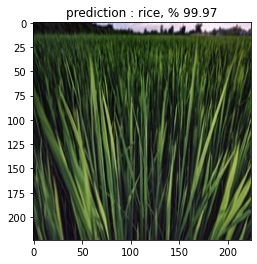

In [21]:
deepmodelpipeline('/kaggle/input/agriculture-crop-images/kag2/rice/rice024ahs.jpeg')

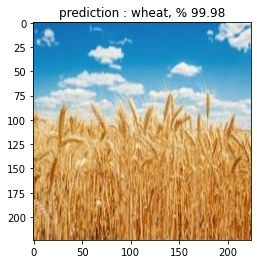

In [22]:
deepmodelpipeline('../input/agriculture-crop-images/kag2/wheat/wheat0004a.jpeg')

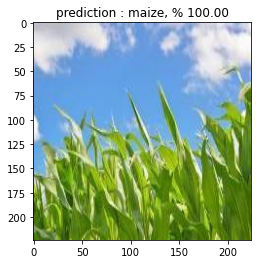

In [23]:
deepmodelpipeline("../input/agriculture-crop-images/kag2/maize/maize008ahf.jpeg")

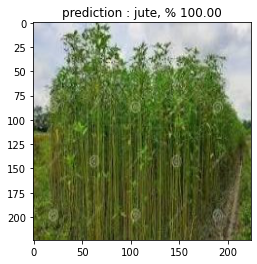

In [24]:
deepmodelpipeline("../input/agriculture-crop-images/kag2/jute/jute005a.jpeg")

# Prediction on test images

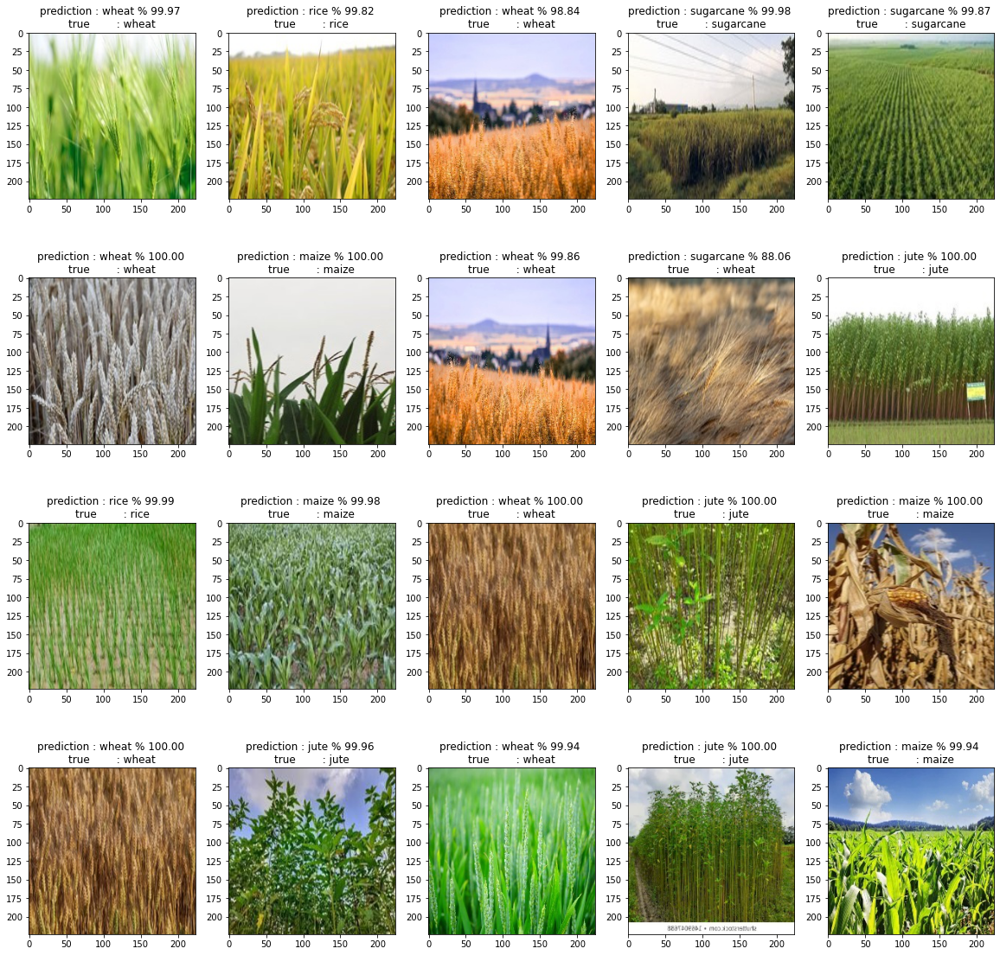

In [25]:
plt.figure(figsize=(20,20))
for num,path in enumerate(X_test[0:20]):
    plt.subplot(4,5,num+1)
    deepmodelpipeline(path,vggmodel,y_test[num])

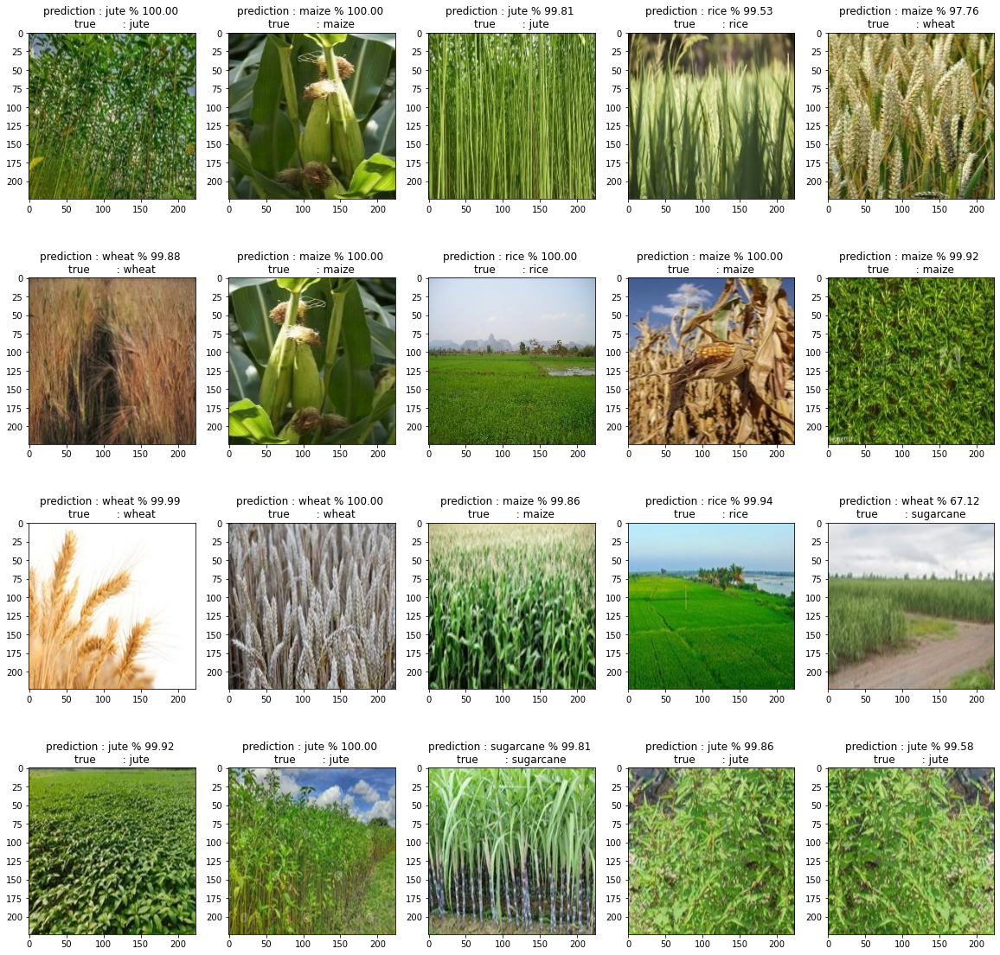

In [26]:
plt.figure(figsize=(20,20))
for num,path in enumerate(X_test[20:40]):
    plt.subplot(4,5,num+1)
    deepmodelpipeline(path,vggmodel,y_test[num+20])

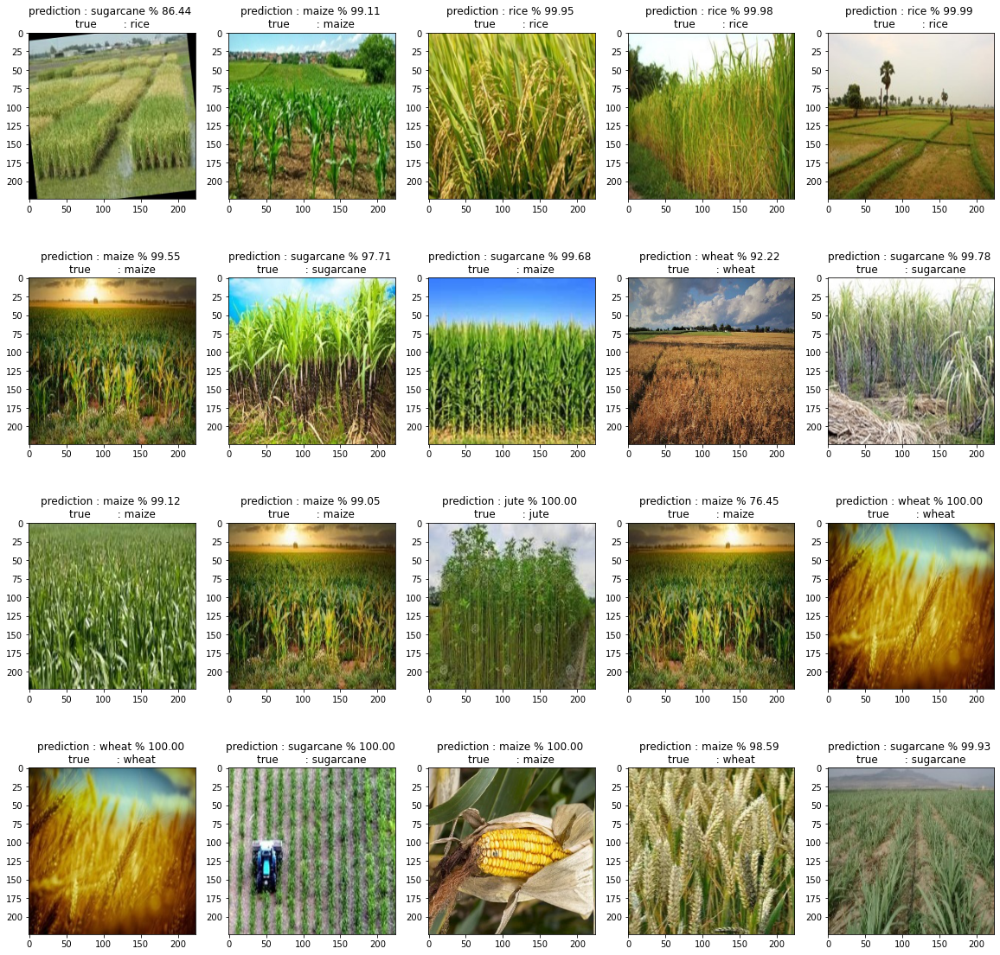

In [27]:
plt.figure(figsize=(20,20))
for num,path in enumerate(X_test[40:60]):
    plt.subplot(4,5,num+1)
    deepmodelpipeline(path,vggmodel,y_test[num+40])

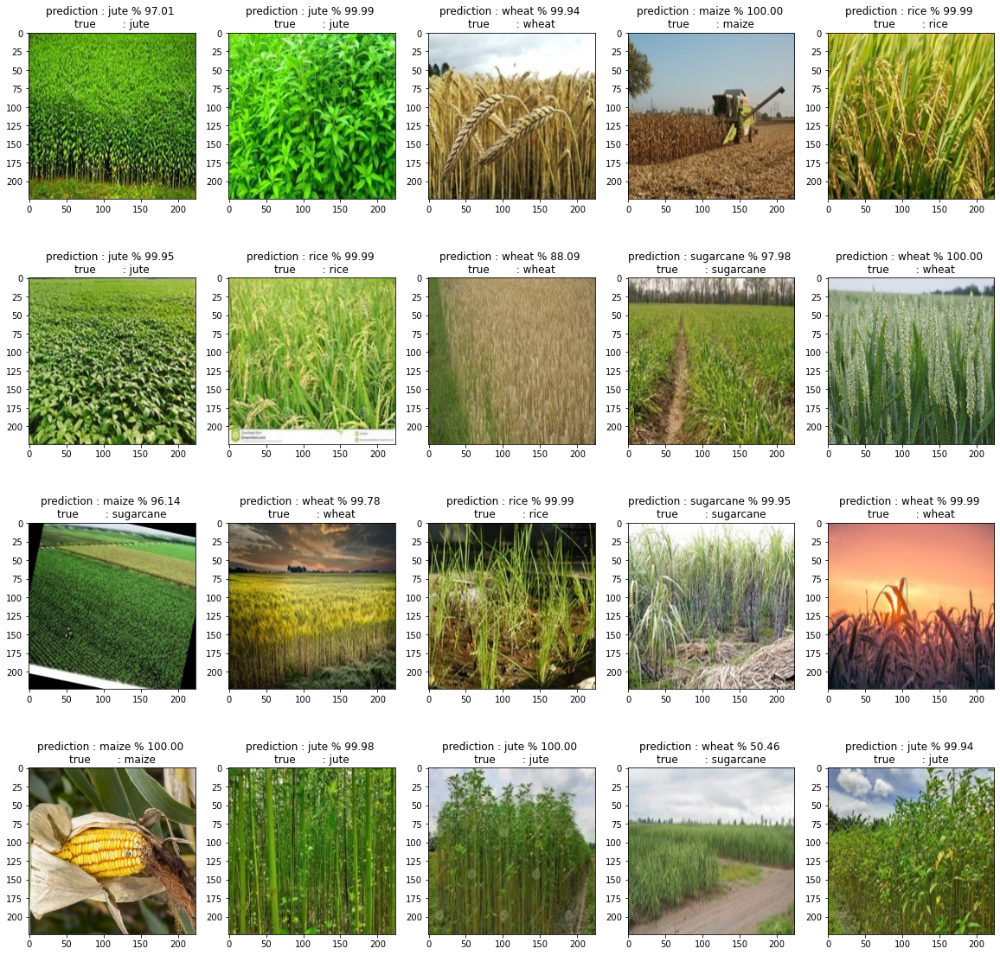

In [28]:
plt.figure(figsize=(20,20))
for num,path in enumerate(X_test[100:120]):
    plt.subplot(4,5,num+1)
    deepmodelpipeline(path,vggmodel,y_test[num+100])

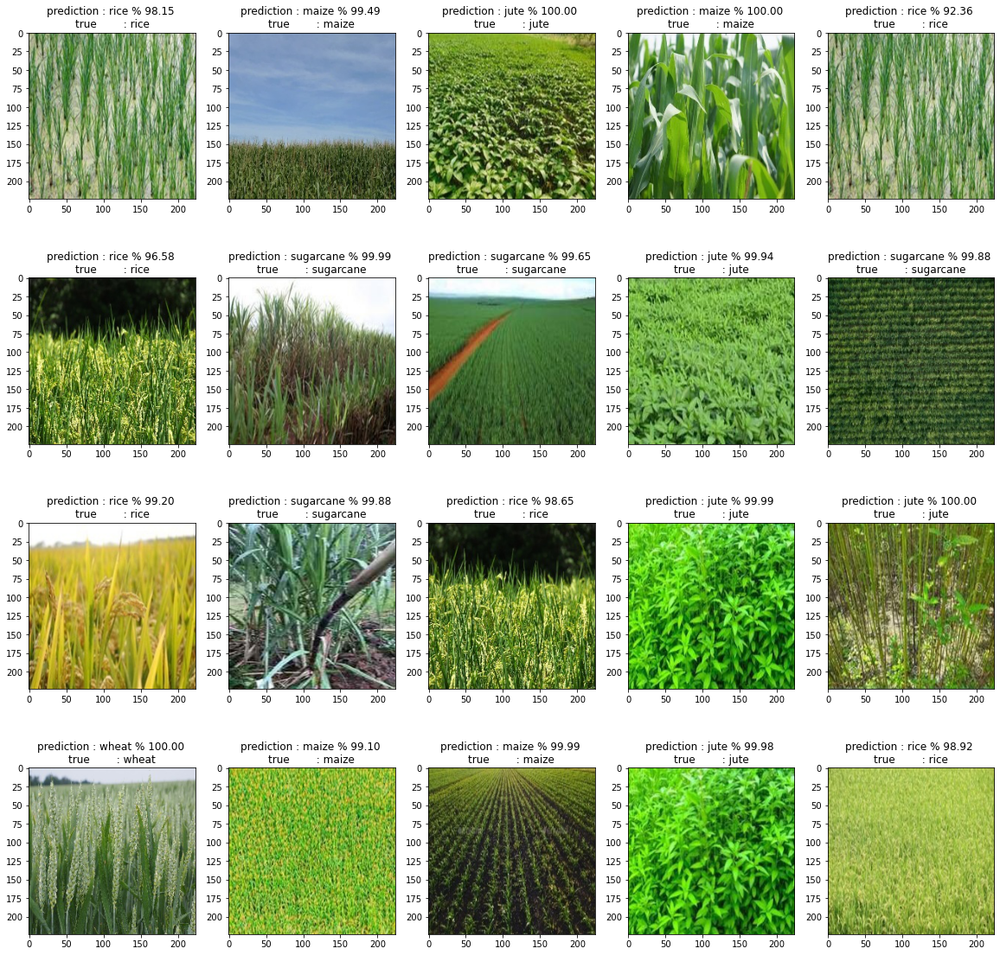

In [29]:
plt.figure(figsize=(20,20))
for num,path in enumerate(X_test[140:160]):
    plt.subplot(4,5,num+1)
    deepmodelpipeline(path,vggmodel,y_test[num+140])

# Saving Model

In [30]:
vggmodel.save_weights("vggmodelweight.h5")

# EVALUATING MODEL ON TESTSSSS DATASET IMAGES

## Loading necessary preprocessing functions

In [31]:
def resize_image(image_array):
    return cv2.resize(image_array,(224,224))
def rescale_image(image_array):
    return image_array*1./255
def read_image(image_path):
    return plt.imread(image_path)
def plot_image(image_array):
    try:
        plt.imshow(image_array)
    except:
        plt.imshow(image_array[0])
def preprocess_image(image_path,reshape = True):
    image = read_image(image_path)
    image = resize_image(image)
    image = rescale_image(image)
    if(reshape ==  True):
        image = image.reshape(-1,image.shape[0],image.shape[1],image.shape[2])    
    return image
def preprocess_imageslist(image_list):
    imagelist = np.array([preprocess_image(img,reshape=False) for img in image_list])
    return imagelist
def predict_and_plot(image,model):
    pred_dict = {0:"jute",1:"maize",2:"rice",3:"sugarcane",4:"wheat"}
    plt.imshow(image[0])
    prediction = model.predict(image) 
    pred = pred_dict[np.argmax(prediction)]
    plt.title(pred)
%matplotlib inline
def predict_and_plot5(imagelist,model):
    pred_dict = {0:"jute",1:"maize",2:"rice",3:"sugarcane",4:"wheat"}
    plt.figure(figsize=(20,10))
    for num,image in enumerate(imagelist):
        plt.subplot(1,5,num+1)
        plt.imshow(image)
        prediction = model.predict(image.reshape(-1,224,224,3)) 
        pred = pred_dict[np.argmax(prediction)]
        plt.title(pred)
def predict_and_plot51(imagelist,model):
    pred_dict = {0:"jute",1:"maize",2:"rice",3:"sugarcane",4:"wheat"}
    plt.figure(figsize=(100,10))
    for i in range(0,55,5):
        predict_and_plot5(imagelist[i:i+5],vggmodel)
def predict_and_plot30(imagelist,model):
    plt.figure(figsize=(40,10))
    for i in range(0,len(imagelist),5):
        predict_and_plot5(imagelist[i:i+5],vggmodel)

In [32]:
testdata = pd.read_csv('../input/testssss/testdata.csv')

In [33]:
imagepath = testdata['testpath'].values
true_label = testdata['croplabel'].values
testdata.head()

,Unnamed: 0,testpath,crop,croplabel
0,0,/kaggle/input/testssss/test_crop_image/wheat-f...,wheat,4
1,1,/kaggle/input/testssss/test_crop_image/jute-fi...,jute,0
2,2,/kaggle/input/testssss/test_crop_image/wheat-c...,wheat,4
3,3,/kaggle/input/testssss/test_crop_image/maize00...,maize,1
4,4,/kaggle/input/testssss/test_crop_image/rice-fi...,rice,2


In [34]:
process_image = preprocess_imageslist(imagepath)

<Figure size 7200x720 with 0 Axes>

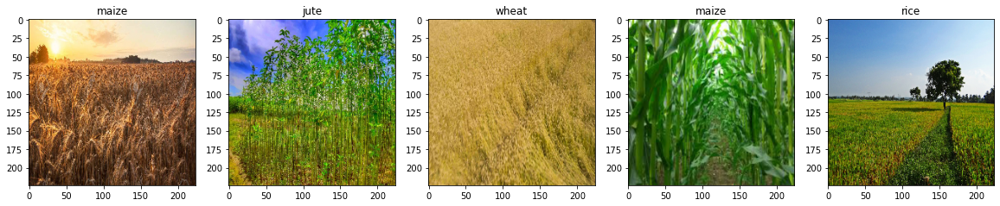

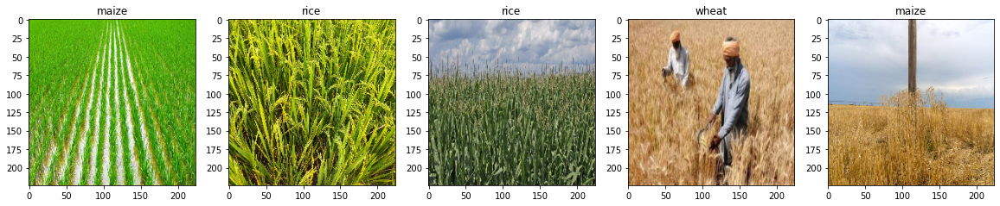

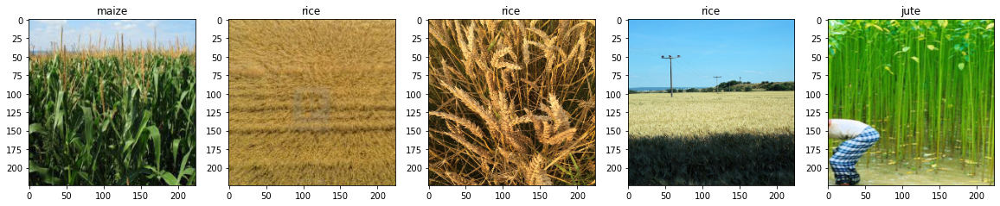

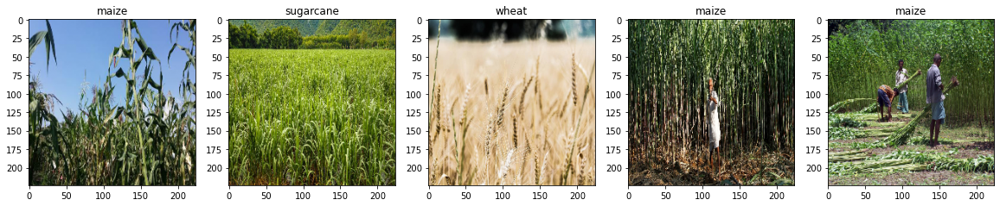

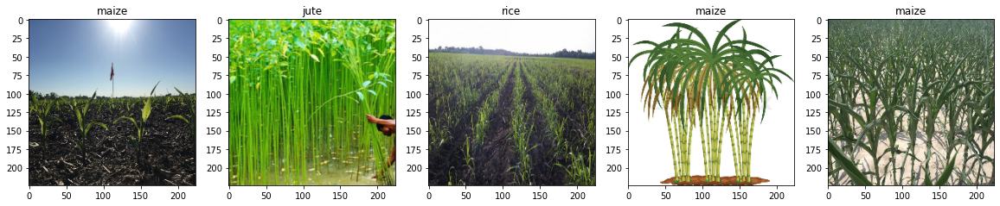

...

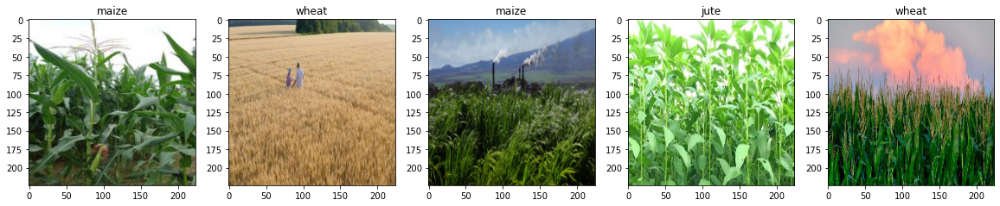

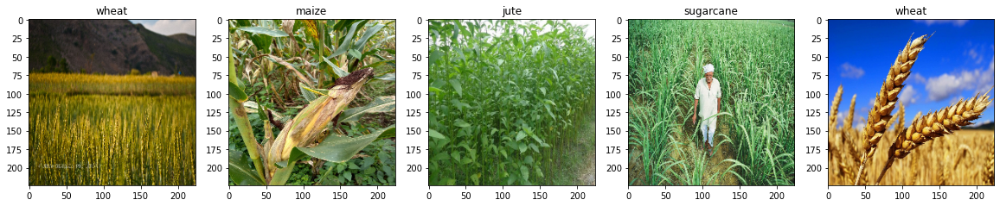

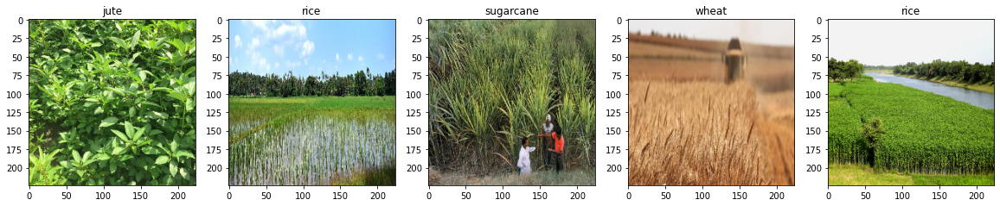

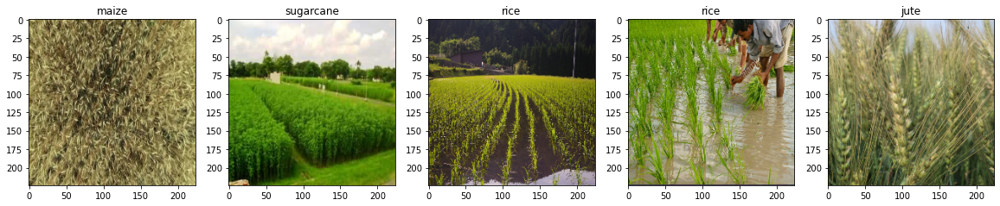

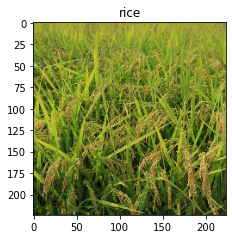

In [35]:
predict_and_plot51(process_image,model=vggmodel)

In [36]:
test_prediction = np.argmax(vggmodel.predict(process_image),axis=1)

In [37]:
accuracy_score(true_label,test_prediction)

0.6274509803921569

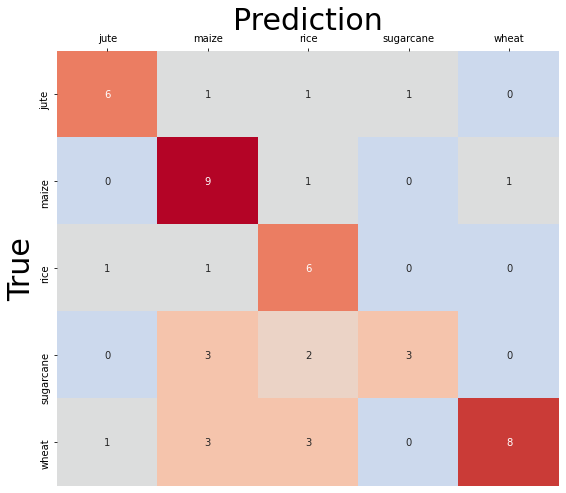

In [38]:
plt.figure(figsize = (9,8))
class_label = ['jute','maize','rice','sugarcane','wheat']
fig = sns.heatmap(confusion_matrix(true_label,test_prediction),cmap= "coolwarm",annot=True,vmin=0,cbar = False,
            center = True,xticklabels=class_label,yticklabels=class_label)
fig.set_xlabel("Prediction",fontsize=30)
fig.xaxis.set_label_position('top')
fig.set_ylabel("True",fontsize=30)
fig.xaxis.tick_top()

In [39]:
classify = true_label==test_prediction
wrong_classify = [num for num,p in enumerate(classify) if p==False]
correct_classify = [num for num,p in enumerate(classify) if p==True]

In [40]:
correct_class_image = process_image[correct_classify]
wrong_class_image = process_image[wrong_classify]

# Wrong classified Images

<Figure size 2880x720 with 0 Axes>

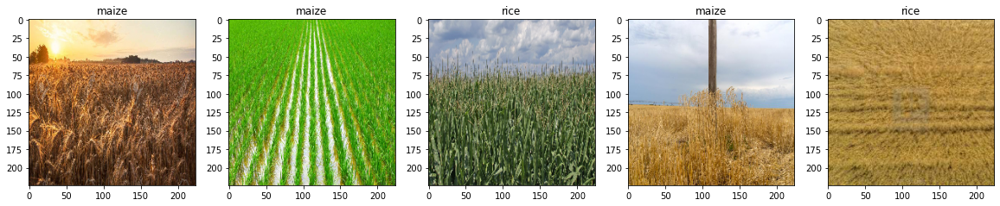

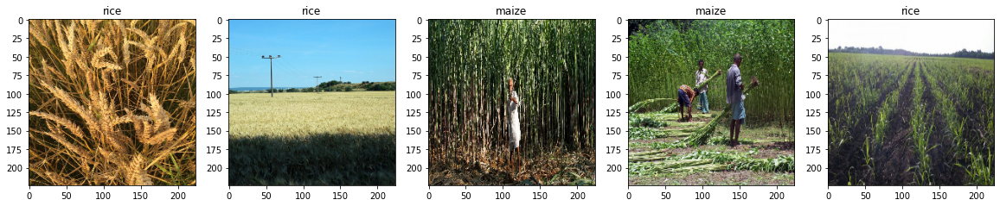

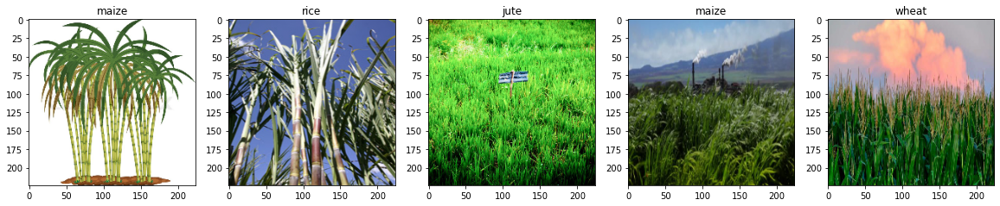

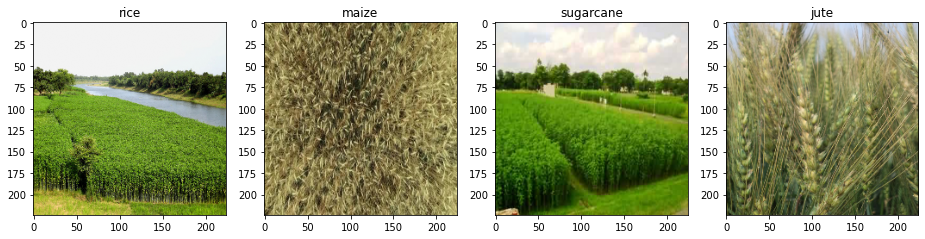

In [41]:
predict_and_plot30(wrong_class_image,vggmodel)

# Correct Classified Images

<Figure size 2880x720 with 0 Axes>

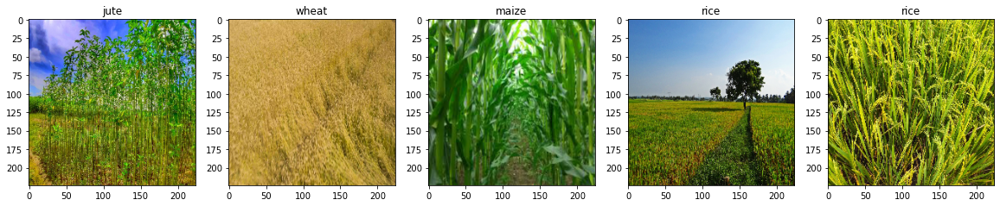

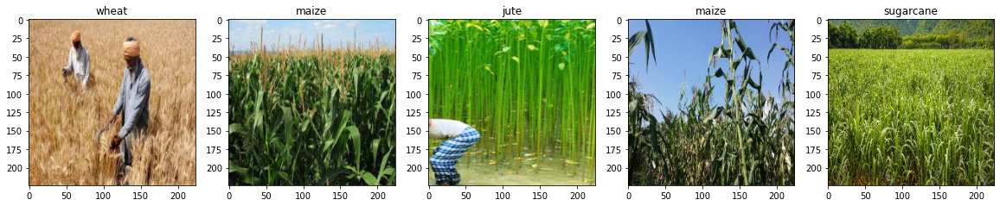

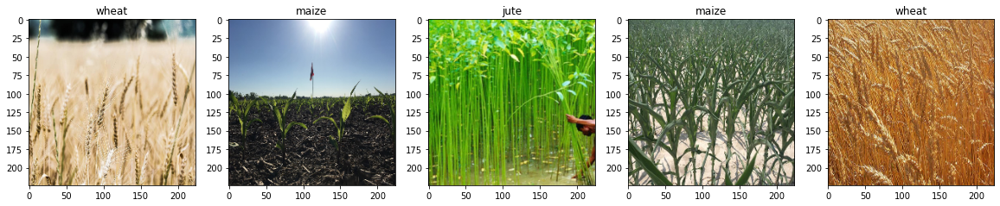

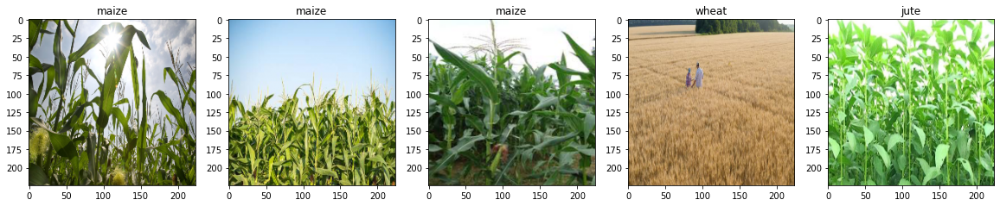

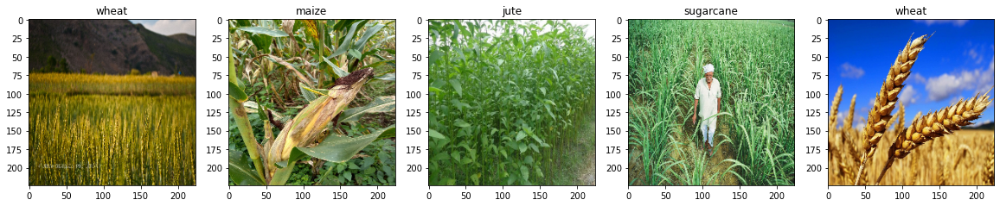

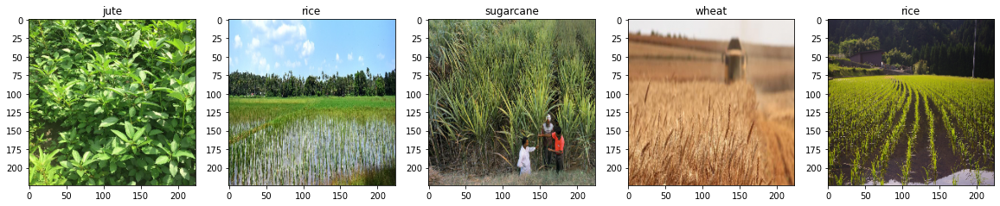

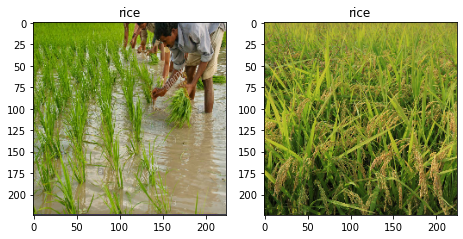

In [42]:
predict_and_plot30(correct_class_image,vggmodel)

# Creating dataframe to submit testssss data prediction

In [43]:
labels = test_prediction.reshape(-1,1)
imagepath = imagepath.reshape(-1,1)
df = pd.DataFrame(np.append(imagepath,labels,axis=1),columns=['pathname','label'])
df.head()

,pathname,label
0,/kaggle/input/testssss/test_crop_image/wheat-f...,1
1,/kaggle/input/testssss/test_crop_image/jute-fi...,0
2,/kaggle/input/testssss/test_crop_image/wheat-c...,4
3,/kaggle/input/testssss/test_crop_image/maize00...,1
4,/kaggle/input/testssss/test_crop_image/rice-fi...,2


In [44]:
df.to_csv('submission.csv')